# ***Importing Libraries and get the dataset***

In [37]:
import joblib
import numpy as np
import pandas as pd
import seaborn as sns
import tensorflow as tf
import plotly.express as px
import matplotlib.pyplot as plt
from tensorflow.keras import metrics
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_curve, auc, classification_report



# **Column Descriptions:**
 - **screen_time_hours** Total daily screen time across all digital devices (in hours).
 - **social_media_platforms_used** Number of different social media platforms used daily.
 - **hours_on_TikTok** Daily time spent specifically on TikTok (in hours).
 - **sleep_hours** Average number of hours the person sleeps per day.
 - **stress_level**Perceived stress level on a likely scale of 1–10(Categorical).
 - **mood_score** Mood rating, likely on a scale of 1–10, where higher is better(Categorical).



# ***Data Descriping and cleaning***

In [2]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("abhishekdave9/digital-habits-vs-mental-health-dataset")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/digital-habits-vs-mental-health-dataset


In [38]:
data = pd.read_csv(path + '/digital_habits_vs_mental_health.csv')
data.head()

,screen_time_hours,social_media_platforms_used,hours_on_TikTok,sleep_hours,stress_level,mood_score
0,10.3,2,5.3,4.4,10,5
1,6.5,5,3.5,6.2,8,8
2,9.1,4,2.8,6.6,7,8
3,6.5,3,2.5,6.5,7,9
4,2.1,3,1.2,7.8,2,10


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 6 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   screen_time_hours            100000 non-null  float64
 1   social_media_platforms_used  100000 non-null  int64  
 2   hours_on_TikTok              100000 non-null  float64
 3   sleep_hours                  100000 non-null  float64
 4   stress_level                 100000 non-null  int64  
 5   mood_score                   100000 non-null  int64  
dtypes: float64(3), int64(3)
memory usage: 4.6 MB


In [5]:
data.describe()

,screen_time_hours,social_media_platforms_used,hours_on_TikTok,sleep_hours,stress_level,mood_score
count,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.00000
mean,6.003505,2.997820,2.401433,6.988489,6.179590,9.06076
std,1.987073,1.414452,1.079111,1.466330,2.045409,1.27847
min,1.000000,1.000000,0.200000,3.000000,1.000000,2.00000
25%,4.700000,2.000000,1.600000,6.000000,5.000000,8.00000
50%,6.000000,3.000000,2.300000,7.000000,6.000000,10.00000
75%,7.300000,4.000000,3.100000,8.000000,8.000000,10.00000
max,12.000000,5.000000,7.200000,10.000000,10.000000,10.00000


In [6]:
data['mood_score'].value_counts()

,count
mood_score,
10,54040
9,18829
8,13721
7,8104
6,3654
5,1249
4,347
3,50
2,6


In [7]:
data['stress_level'].value_counts()

,count
stress_level,
6,18516
7,17274
5,16119
8,13041
4,11381
9,7719
3,6207
10,6119
2,2592


In [8]:
data.duplicated().sum()

np.int64(1865)

In [39]:
data.drop_duplicates(inplace=True)

In [10]:
data.isnull().sum()

,0
screen_time_hours,0
social_media_platforms_used,0
hours_on_TikTok,0
sleep_hours,0
stress_level,0
mood_score,0


In [11]:
df_melted = data.melt(var_name='Feature', value_name='Value')

fig = px.box(df_melted, x='Feature', y='Value', title='Boxplots for All Features',
             points="outliers",
             color='Feature')
fig.update_layout(xaxis_title="Feature", yaxis_title="Value")
fig.show()


In [40]:
for col in ['screen_time_hours', 'hours_on_TikTok']:
    Q1 = data[col].quantile(0.25)
    Q3 = data[col].quantile(0.75)
    IQR = Q3 - Q1
    lb = Q1 - 1.5 * IQR
    ub = Q3 + 1.5 * IQR

    mask = (data[col] < lb) | (data[col] > ub)
    indices = data[mask].index
    data.loc[indices, col] = np.random.uniform(Q1, Q3, size=len(indices))


In [41]:
df_melted = data.melt(var_name='Feature', value_name='Value')

fig = px.box(df_melted, x='Feature', y='Value', title='Boxplots for All Features',
             points="outliers",
             color='Feature')
fig.update_layout(xaxis_title="Feature", yaxis_title="Value")
fig.show()


#**Feature Engineering**

In [60]:
fig = px.histogram(
    data,
    x='stress_level',
    color='mood_score',
    barmode='stack'
)
fig.show()


In [42]:
data['stress_class'] = 0  # default value

data.loc[data['stress_level'] <= 6, 'stress_class'] = 0
data.loc[(data['stress_level'] >= 7)&(data['stress_level'] <= 8), 'stress_class'] = 1
data.loc[data['stress_level'] >= 9 , 'stress_class'] = 2

In [43]:
data['mood_class'] = 0  # default value

data.loc[data['mood_score'] < 8, 'mood_class'] = 0
data.loc[(data['mood_score'] >=8) & (data['mood_score'] <= 9), 'mood_class'] = 1
data.loc[data['mood_score'] == 10, 'mood_class'] = 2

In [8]:
fig = px.histogram(
    data,
    x='stress_class',
    color='mood_class',
    barmode='stack'
)
fig.show()


# **EDA**

In [ ]:
fig = px.violin(
    data_frame=data,
    x='mood_score',
    y='screen_time_hours',
    color='mood_score',
    box=True,
    points='all',
    title='Distribution of Screen Time Hours Across Mood Scores',
    labels={
        'mood_score': 'Mood Score',
        'screen_time_hours': 'Daily Screen Time (Hours)'
    }
)
fig.show()


In [ ]:
# Relationship between Time spent Alone and Personality

counts = data.groupby(['mood_score', 'social_media_platforms_used']).size().reset_index(name='count')

fig = px.histogram(
    counts,
    x='social_media_platforms_used',
    y='count',
    color='mood_score',
    barmode='group',
    title='Distribution of Social Media Platforms Used by Mood Score',
    labels={
        'social_media_platforms_used': 'Social Media Platforms Used',
        'count': 'Number of People',
        'mood_score': 'Mood Score'
    }
)
fig.show()

In [ ]:
fig = px.violin(
    data_frame=data,
    x='mood_score',
    y='hours_on_TikTok',
    color='mood_score',
    box=True,
    points='all',
    title='Distribution of TikTok Usage Hours by Mood Score',
    labels={
        'mood_score': 'Mood Score',
        'hours_on_TikTok': 'Hours Spent on TikTok'
    },
    category_orders={'mood_score': sorted(data['mood_score'].unique())}

)
fig.show()


In [ ]:
fig = px.violin(
    data_frame=data,
    x='mood_score',
    y='sleep_hours',
    color='mood_score',
    box=True,
    points='all',
    title='Distribution of Sleep Hours by Mood Score',
    labels={
        'mood_score': 'Mood Score',
        'sleep_hours': 'Sleep Hours'
    },
    category_orders={'mood_score': sorted(data['mood_score'].unique())}

)
fig.show()


In [ ]:
counts = data.groupby(['mood_score', 'stress_level']).size().reset_index(name='count')

fig = px.histogram(
    counts,
    x='stress_level',
    y='count',
    color='mood_score',
    barmode='group',
    title='Distribution of Stress Levels by Mood Score',
    labels={
        'mood_score': 'Mood Score',
        'stress_level': 'Stress Level'
    }
)
fig.show()


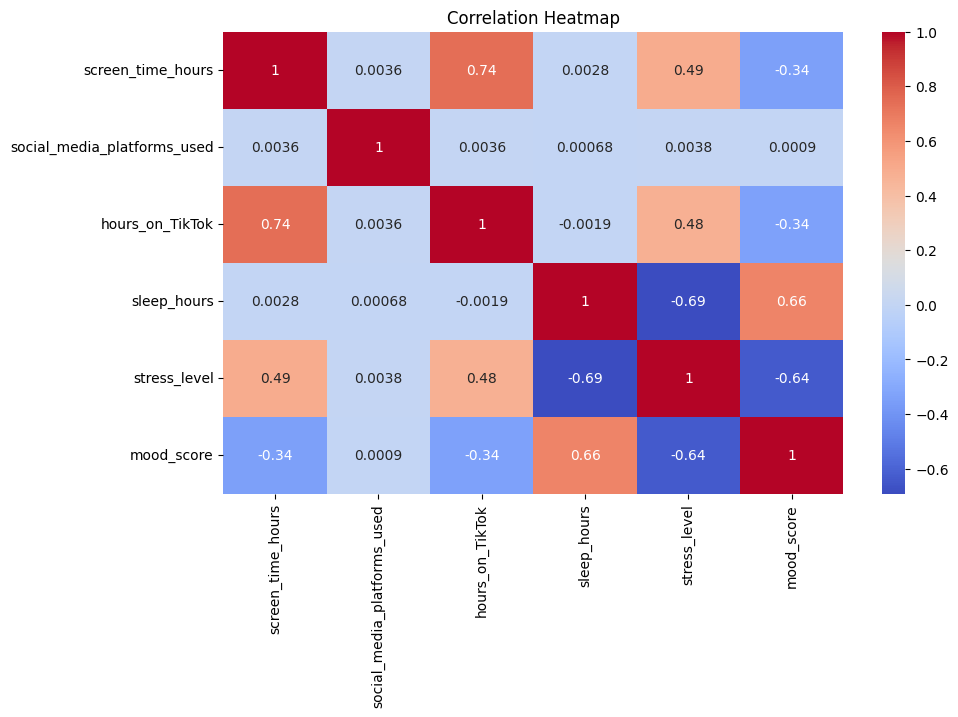

In [ ]:
plt.figure(figsize=(10, 6))
sns.heatmap(data.corr(),annot=True, cmap='coolwarm')
plt.title("Correlation Heatmap")
plt.show()

# **Modeling**

In [44]:
xS = data.drop(['social_media_platforms_used','stress_level','mood_score','stress_class'],axis=1)
yS = data['stress_class']

In [45]:
x_trainS,x_testS,y_trainS,y_testS = train_test_split(xS,yS,test_size=0.2,random_state=42)


In [53]:
num_classes = len(np.unique(y_trainS))

y_trainS_cat = to_categorical(y_trainS, num_classes=num_classes)
y_testS_cat  = to_categorical(y_testS,  num_classes=num_classes)

In [47]:
model_stress = tf.keras.models.Sequential([
    tf.keras.layers.InputLayer(input_shape =(len(xS.columns),)),
    tf.keras.layers.Dense(units=70,activation='relu'),
    tf.keras.layers.Dense(units=50,activation='relu'),
    tf.keras.layers.Dense(units=10,activation='relu'),
    tf.keras.layers.Dense(units=20,activation='relu'),
    tf.keras.layers.Dense(units=30,activation='relu'),
    tf.keras.layers.Dense(units=5,activation='relu'),
    tf.keras.layers.Dense(units=len(y_trainS.unique()),activation='softmax')
                                       ])

model_stress.compile(
    optimizer = tf.keras.optimizers.Adam(),
    loss = tf.keras.losses.CategoricalCrossentropy(),
    metrics = ['accuracy']
)

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning:

Argument `input_shape` is deprecated. Use `shape` instead.



In [54]:
hist = model_stress.fit(
    x_trainS, y_trainS_cat,
    validation_data=(x_testS, y_testS_cat),
    epochs=10,
    batch_size=32
)

y_pred_probs = model_stress.predict(x_testS)
y_pred_class = np.argmax(y_pred_probs, axis=1)
y_true_class = np.argmax(y_testS_cat, axis=1)
print(classification_report(y_true_class, y_pred_class))

Epoch 1/10
2454/2454 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.7606 - loss: 0.5231 - val_accuracy: 0.7583 - val_loss: 0.5272
Epoch 2/10
2454/2454 ━━━━━━━━━━━━━━━━━━━━ 10s 3ms/step - accuracy: 0.7633 - loss: 0.5199 - val_accuracy: 0.7582 - val_loss: 0.5293
Epoch 3/10
2454/2454 ━━━━━━━━━━━━━━━━━━━━ 10s 3ms/step - accuracy: 0.7591 - loss: 0.5244 - val_accuracy: 0.7584 - val_loss: 0.5276
Epoch 4/10
2454/2454 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - accuracy: 0.7568 - loss: 0.5246 - val_accuracy: 0.7572 - val_loss: 0.5287
Epoch 5/10
2454/2454 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.7599 - loss: 0.5213 - val_accuracy: 0.7565 - val_loss: 0.5296
Epoch 6/10
2454/2454 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.7601 - loss: 0.5240 - val_accuracy: 0.7537 - val_loss: 0.5317
Epoch 7/10
2454/2454 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.7598 - loss: 0.5264 - val_accuracy: 0.7557 - val_loss: 0.5313
Epoch 8/10
2454/2454 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.7592 - loss: 0.5231 

In [70]:
xm = data.drop(['social_media_platforms_used','mood_score','mood_class'],axis=1)
ym = data['mood_class']

In [71]:
x_trainM,x_testM,y_trainM,y_testM = train_test_split(xm,ym,test_size=0.2,random_state=42)


In [72]:
num_classes = len(np.unique(y_trainM))

y_trainM_cat = to_categorical(y_trainM, num_classes=num_classes)
y_testM_cat  = to_categorical(y_testM,  num_classes=num_classes)

In [79]:
model_mood = tf.keras.models.Sequential([
    tf.keras.layers.InputLayer(input_shape =(len(xm.columns),)),
    tf.keras.layers.Dense(units=50,activation='relu'),
    tf.keras.layers.Dense(units=70,activation='relu'),
    tf.keras.layers.Dense(units=30,activation='relu'),
    tf.keras.layers.Dense(units=20,activation='relu'),
    tf.keras.layers.Dense(units=60,activation='relu'),
    tf.keras.layers.Dense(units=10,activation='relu'),
    tf.keras.layers.Dense(units=len(y_trainM.unique()),activation='softmax')
                                       ])

model_mood.compile(
    optimizer = tf.keras.optimizers.Adam(),
    loss = tf.keras.losses.CategoricalCrossentropy(),
    metrics = ['accuracy']
)

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning:

Argument `input_shape` is deprecated. Use `shape` instead.



In [80]:
hist = model_mood.fit(
    x_trainM, y_trainM_cat,
    validation_data=(x_testM, y_testM_cat),
    epochs=15,
    batch_size=32
)

y_pred_probs = model_mood.predict(x_testM)
y_pred_class = np.argmax(y_pred_probs, axis=1)
y_true_class = np.argmax(y_testM_cat, axis=1)
print(classification_report(y_true_class, y_pred_class))

Epoch 1/15
2454/2454 ━━━━━━━━━━━━━━━━━━━━ 12s 4ms/step - accuracy: 0.7231 - loss: 0.6173 - val_accuracy: 0.7409 - val_loss: 0.5622
Epoch 2/15
2454/2454 ━━━━━━━━━━━━━━━━━━━━ 17s 3ms/step - accuracy: 0.7367 - loss: 0.5766 - val_accuracy: 0.7433 - val_loss: 0.5580
Epoch 3/15
2454/2454 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.7411 - loss: 0.5685 - val_accuracy: 0.7331 - val_loss: 0.5747
Epoch 4/15
2454/2454 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - accuracy: 0.7416 - loss: 0.5645 - val_accuracy: 0.7451 - val_loss: 0.5589
Epoch 5/15
2454/2454 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - accuracy: 0.7381 - loss: 0.5669 - val_accuracy: 0.7430 - val_loss: 0.5559
Epoch 6/15
2454/2454 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.7380 - loss: 0.5688 - val_accuracy: 0.7466 - val_loss: 0.5513
Epoch 7/15
2454/2454 ━━━━━━━━━━━━━━━━━━━━ 10s 3ms/step - accuracy: 0.7364 - loss: 0.5695 - val_accuracy: 0.7460 - val_loss: 0.5593
Epoch 8/15
2454/2454 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.7427 - loss: 0.563

In [81]:
# Save models
joblib.dump(model_mood, "model_mood.pkl")
joblib.dump(model_stress, "model_stress.pkl")

print(" Models saved successfully!")


 Models saved successfully!


In [82]:
data

,screen_time_hours,social_media_platforms_used,hours_on_TikTok,sleep_hours,stress_level,mood_score,stress_class,mood_class
0,10.3,2,5.3,4.4,10,5,2,0
1,6.5,5,3.5,6.2,8,8,1,1
2,9.1,4,2.8,6.6,7,8,1,1
3,6.5,3,2.5,6.5,7,9,1,1
4,2.1,3,1.2,7.8,2,10,0,2
...,...,...,...,...,...,...,...,...
99995,5.0,4,1.8,4.5,10,9,2,1
99996,6.4,3,3.1,5.4,10,5,2,0
99997,3.7,3,1.5,8.3,4,10,0,2
99998,10.6,2,5.3,7.2,9,9,2,1


In [85]:
# Load models
model_mood = joblib.load("model_mood.pkl")
model_stress = joblib.load("model_stress.pkl")


# New customer raw data
# Format: [num1, num2, num3, num4]
user_features_stress  = [7.0, 2, 0.0, 5.0]

#Predict stress
stress_array = np.array(user_features_stress).reshape(1, -1)
predicted_stress_probs = model_stress.predict(stress_array)
predicted_stress_class = np.argmax(predicted_stress_probs, axis=1)[0]

print(f"Predicted Stress Class: {predicted_stress_class}")

# Prepare input for mood model
mood_input_features = [7.0, 0.0, 5.0, 4.0, predicted_stress_class]  # Adjust to match xm column order

mood_array = np.array(mood_input_features).reshape(1, -1)

# Predict mood
predicted_mood_probs = model_mood.predict(mood_array)
predicted_mood_class = np.argmax(predicted_mood_probs, axis=1)[0]

print(f"Predicted Mood Class: {predicted_mood_class}")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step
Predicted Stress Class: 2


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step
Predicted Mood Class: 0
